# Demo Run

In [1]:
# %load_ext autoreload
# %autoreload 2
# # # this may cause DisentenglementTargetManager to reimported, losing all the data e.g. configurations.

In [2]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
plt.rcParams["font.family"] = "DeJavu Serif"
plt.rcParams["font.serif"] = ["Times New Roman"]

In [3]:
import os
import sys
import gc
import warnings
import anndata as ad
import scanpy as sc
import numpy as np
import pandas as pd
import copy
import torch
from pathlib import Path

sys.path.append(str(Path(os.getcwd()).resolve().parents[0]))
import tardis

local_run = False
if local_run:
    tardis.config = tardis.config_local
else:
    tardis.config = tardis.config_server
print(f"CUDA used: {torch.cuda.is_available()}")

CUDA used: True


In [4]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "dataset_subset_age_sex_1.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata.obs["age"] = adata.obs["age"].astype("str").astype("category")

AnnData object with n_obs × n_vars = 27033 × 2048
    obs: 'sample_ID', 'organ', 'age', 'cell_type', 'sex', 'sex_inferred', 'concatenated_integration_covariates', 'integration_donor', 'integration_biological_unit', 'integration_sample_status', 'integration_library_platform_coarse', 'n_genes'
    uns: 'rank_genes_groups'

In [ ]:
updated_obs = pd.read_csv(
    os.path.join("/lustre/groups/ml01/workspace/kemal.inecik/hdca/data", "metadata", "combined_with_hierarchy", "anno_V1.csv"),
    index_col="Unnamed: 0"
)
new_cols = ['LVL3', 'LVL2', 'LVL1', 'LVL0']
adata.obs = pd.concat([adata.obs.copy(), updated_obs.loc[adata.obs.index][new_cols]], axis=1)
adata

## Train

In [5]:
# warmup_epoch_range = [10, 100]
# # _, n_epochs_kl_warmup = warmup_epoch_range
# n_epochs_kl_warmup = 400

# counteractive_minibatch_settings = dict(
#     method = "categorical_random",
#     method_kwargs = dict(
#         within_labels = False,
#         within_batch = False,
#         within_categorical_covs = None,
#         seed = "forward",
#     )
# )

# disentenglement_targets_configurations=[
#     dict(
#         obs_key = "age",
#         n_reserved_latent = 20,
#         counteractive_minibatch_settings = counteractive_minibatch_settings,
#         auxillary_losses = [
#             dict(
#                 apply = True, 
#                 target_type="categorical",
#                 progress_bar = True,
#                 weight = 100,
#                 method = "mse_z", 
#                 latent_group = "reserved",
#                 counteractive_example = "negative",
#                 transformation = "inverse", 
#                 warmup_epoch_range=warmup_epoch_range,
#                 method_kwargs = {}
#             ),
#             dict(
#                 apply = True, 
#                 target_type="categorical",
#                 progress_bar = False,
#                 weight = 10, 
#                 method = "mse_z", 
#                 latent_group = "reserved",
#                 counteractive_example = "positive",
#                 transformation = "none",
#                 warmup_epoch_range=warmup_epoch_range,
#                 method_kwargs = {}
#             ),
#         ]
#     ),
#     dict(
#         obs_key = "sex",
#         n_reserved_latent = 20,
#         counteractive_minibatch_settings = counteractive_minibatch_settings,
#         auxillary_losses = [
#             dict(
#                 apply = True, 
#                 target_type="categorical",
#                 progress_bar = True,
#                 weight = 100,
#                 method = "mse_z", 
#                 latent_group = "reserved",
#                 counteractive_example = "negative",
#                 transformation = "inverse", 
#                 warmup_epoch_range=warmup_epoch_range,
#                 method_kwargs = {}
#             ),
#             dict(
#                 apply = True, 
#                 target_type="categorical",
#                 progress_bar = False,
#                 weight = 10, 
#                 method = "mse_z", 
#                 latent_group = "reserved",
#                 counteractive_example = "positive",
#                 transformation = "none",
#                 warmup_epoch_range=warmup_epoch_range,
#                 method_kwargs = {}
#             ),
#         ]
#     )
# ]

# model_params = dict(
#     n_hidden=512,
#     n_layers=3, 
#     n_latent=60, 
#     gene_likelihood = "nb",
#     use_batch_norm = "none",
#     use_layer_norm = "both",
#     dropout_rate = 0.1,
#     include_auxillary_loss = True
# )

# train_params = dict(
#     max_epochs=2000,
#     train_size=0.8,
#     batch_size=512,
#     check_val_every_n_epoch=10,
#     learning_rate_monitor=True,
#     # early stopping:
#     early_stopping=True,
#     early_stopping_patience=150,
#     early_stopping_monitor="elbo_train",
#     plan_kwargs = dict(
#         n_epochs_kl_warmup=n_epochs_kl_warmup,
#         lr=1e-3,
#         weight_decay=1e-6,
#         # optimizer="AdamW"
#         # lr-scheduler:
#         reduce_lr_on_plateau=True,
#         lr_patience=100,
#         lr_scheduler_metric="elbo_train",
#     )
# )

# dataset_params = dict(
#     layer=None, 
#     labels_key="cell_type",
#     batch_key="concatenated_integration_covariates",
#     categorical_covariate_keys=None,
#     disentenglement_targets_configurations=disentenglement_targets_configurations
# )

# tardis.MyModel.setup_anndata(adata, **dataset_params)

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

# vae = tardis.MyModel(adata, **model_params)
# vae.train(**train_params)

In [6]:
# dir_path = os.path.join(
#     tardis.config.io_directories["models"],
#     "run7"
# )

# vae.save(
#     dir_path,
#     overwrite=False,
# )

## Load Model

In [6]:
dir_path = os.path.join(
    tardis.config.io_directories["models"],
    "run7"
)
vae = tardis.MyModel.load(dir_path, adata=adata)

INFO     File /lustre/groups/ml01/workspace/kemal.inecik/tardis_data/models/run7/model.pt already downloaded       


CUDA backend failed to initialize: Unable to use CUDA because of the following issues with CUDA components:
Outdated CUDA installation found.
Version JAX was built against: 11080
Minimum supported: 12010
Installed version: 11080
The local installation version must be no lower than 12010.
--------------------------------------------------
Outdated cuDNN installation found.
Version JAX was built against: 8800
Minimum supported: 8900
Installed version: 8700
The local installation version must be no lower than 8900.
--------------------------------------------------
Outdated cuBLAS installation found.
Version JAX was built against: 111103
Minimum supported: 120100
Installed version: 111103
The local installation version must be no lower than 120100.
--------------------------------------------------
Outdated cuSPARSE installation found.
Version JAX was built against: 11705
Minimum supported: 12100
Installed version: 11705
The local installation version must be no lower than 12100. (Set TF_

## Check training

In [11]:
# vae.plot_training_history(
#     ignore_first=0, 
#     n_col=4,
#     metrics_name=[
#         "reconstruction_loss", "kl_local", "elbo", "total_loss",
#         #
#         "tardis_age_0_weighted", 
#         "tardis_age_0",
#         "tardis_age_1_weighted", 
#         "tardis_age_1",
#         #
#         "tardis_sex_0_weighted", 
#         "tardis_sex_0",
#         "tardis_sex_1_weighted", 
#         "tardis_sex_1",
#     ]
# )

In [9]:
# from tardis._disentenglementtargetmanager import DisentenglementTargetManager
# display(np.array(DisentenglementTargetManager.configurations.get_by_obs_key("age").reserved_latent_indices))
# display(np.array(DisentenglementTargetManager.configurations.get_by_obs_key("sex").reserved_latent_indices))

In [10]:
# vae.plot_latent_kde(
#     adata_obs=adata.obs,
#     target_obs_key="sex",
#     latent_representation=vae.get_latent_representation(),
#     latent_dim_of_interest=None
# )

# Metrics

In [7]:
batch_size_vae_metrics = 512
vae_metrics = {
    "reconstruction_error": vae.get_reconstruction_error(batch_size=batch_size_vae_metrics)['reconstruction_loss'],
    "elbo": vae.get_elbo(batch_size=batch_size_vae_metrics).item(),
    "r2_train": vae.get_reconstruction_r2(batch_size=batch_size_vae_metrics, indices=vae.train_indices),
    "r2_train_deg_20": vae.get_reconstruction_r2(top_n_differentially_expressed_genes=20, batch_size=batch_size_vae_metrics, indices=vae.train_indices),
    "r2_train_deg_50": vae.get_reconstruction_r2(top_n_differentially_expressed_genes=50, batch_size=batch_size_vae_metrics, indices=vae.train_indices),
    "r2_validation": vae.get_reconstruction_r2(batch_size=batch_size_vae_metrics, indices=vae.validation_indices),
    "r2_validation_deg_20": vae.get_reconstruction_r2(top_n_differentially_expressed_genes=20, batch_size=batch_size_vae_metrics, indices=vae.validation_indices),
    "r2_validation_deg_50": vae.get_reconstruction_r2(top_n_differentially_expressed_genes=50, batch_size=batch_size_vae_metrics, indices=vae.validation_indices),
}
for k, v in vae_metrics.items():
    print(k, v)

reconstruction_error -182.1336211181704
elbo -216.9307861328125
r2_train 0.9303489089642499
r2_train_deg_20 0.8585182148968205
r2_train_deg_50 0.8744889511702229
r2_validation 0.8809879666791843
r2_validation_deg_20 0.6632867311088254
r2_validation_deg_50 0.7836770169481135


# Visualization

In [21]:
def prepare(ad_latent):
    sc.pp.neighbors(ad_latent, n_neighbors = 30)
    sc.tl.umap(ad_latent)
    sc.tl.diffmap(adata=ad_latent)
    ad_latent.obs["age_cont"] = ad_latent.obs['age'].astype(float)
    root_age = ad_latent.obs["age_cont"].min()
    ad_latent.uns['iroot'] = np.flatnonzero(ad_latent.obs['age'] == str(root_age))[0]
    sc.tl.dpt(ad_latent)

In [22]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
prepare(latent)
latent

         Falling back to preprocessing with `sc.pp.pca` and default params.


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 27033 × 60
    obs: 'sample_ID', 'organ', 'age', 'cell_type', 'sex', 'sex_inferred', 'concatenated_integration_covariates', 'integration_donor', 'integration_biological_unit', 'integration_sample_status', 'integration_library_platform_coarse', 'n_genes', 'LVL3', 'LVL2', 'LVL1', 'LVL0', '_scvi_batch', '_scvi_labels', 'age_cont', 'dpt_pseudotime'
    uns: 'neighbors', 'umap', 'diffmap_evals', 'iroot'
    obsm: 'X_pca', 'X_umap', 'X_diffmap'
    obsp: 'distances', 'connectivities'

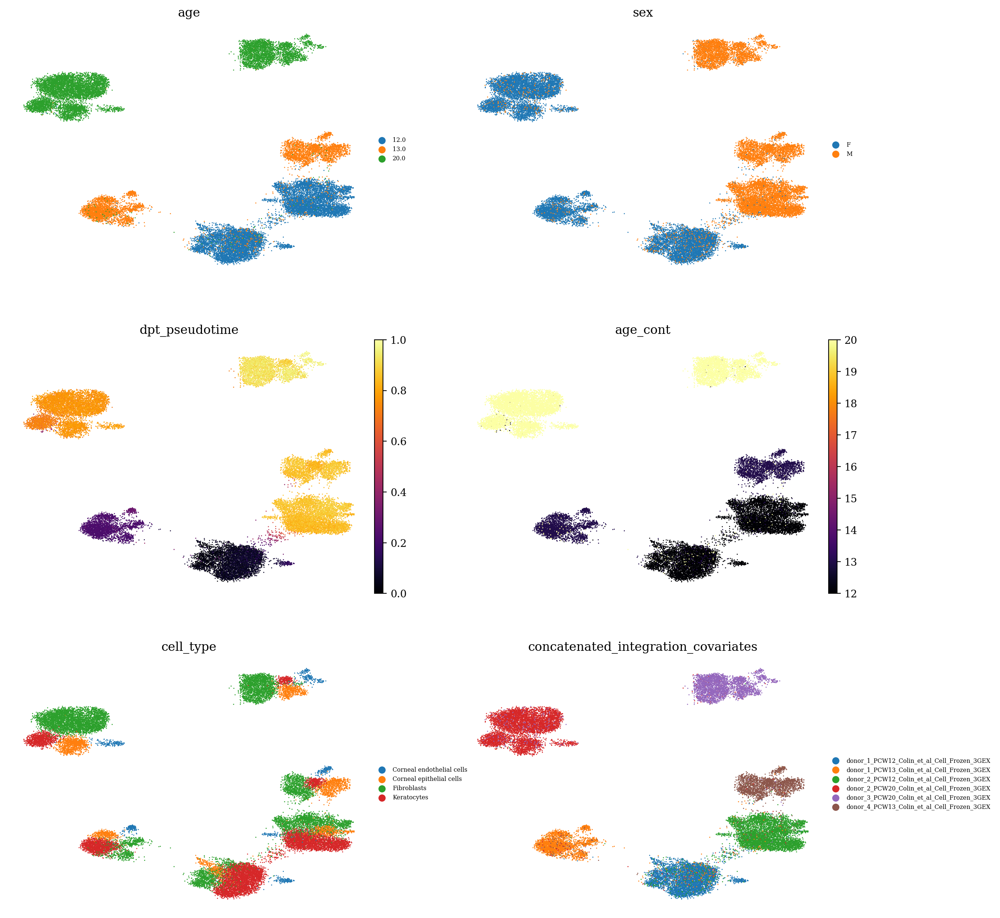

In [19]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=["age", "sex", "dpt_pseudotime", "age_cont", "cell_type", "concatenated_integration_covariates"], 
        ncols=2,
        frameon=False,
        color_map="inferno",
        legend_fontsize="xx-small"
    )

In [23]:
del latent
gc.collect();

(27033, 40)

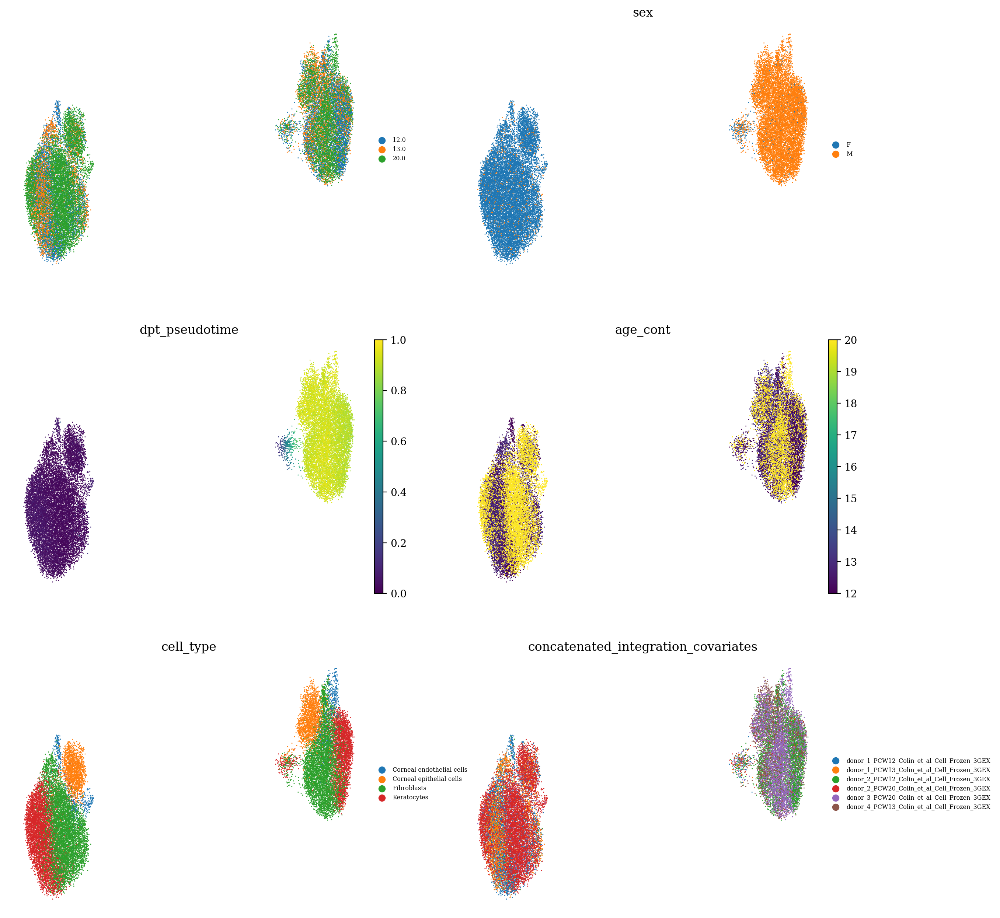

In [24]:
from tardis._disentenglementtargetmanager import DisentenglementTargetManager
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.get_by_obs_key("age").unreserved_latent_indices], obs=adata.obs.copy())
prepare(latent)
display(latent.shape)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=["age", "sex", "dpt_pseudotime", "age_cont", "cell_type", "concatenated_integration_covariates"], 
        ncols=2,
        frameon=False,
        title="",
        legend_fontsize="xx-small"
    )

del latent
gc.collect();

(27033, 40)

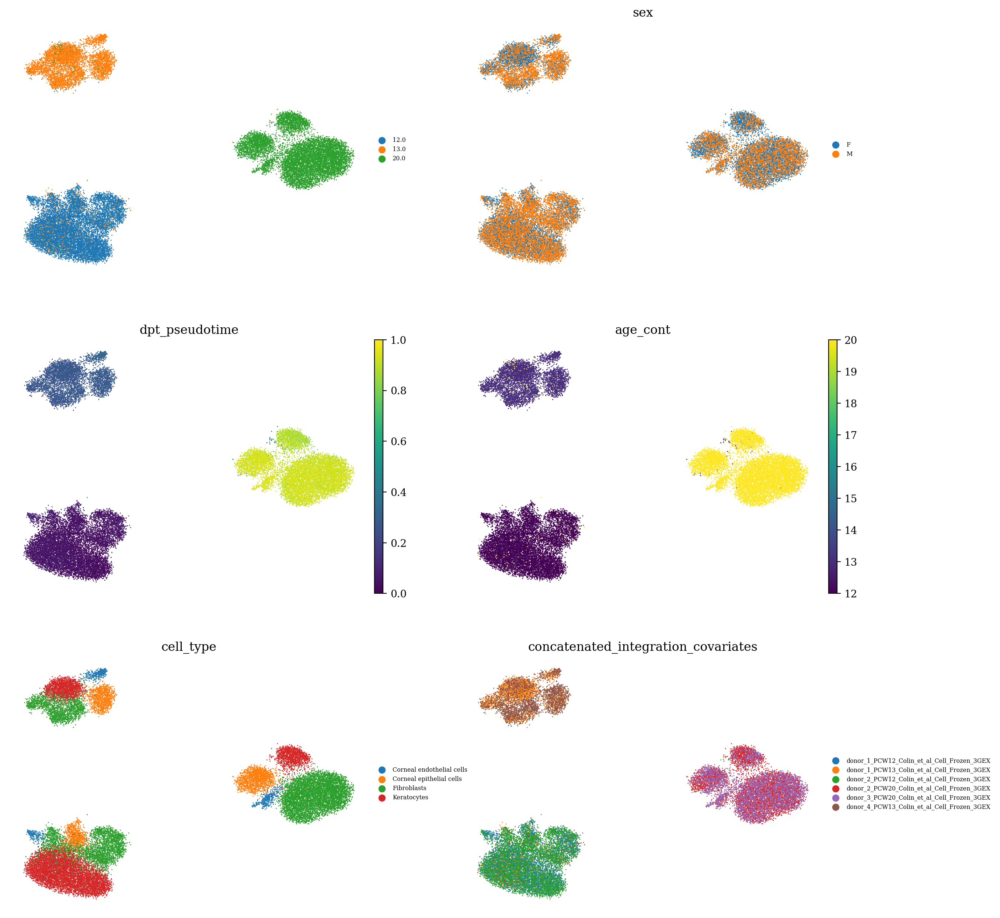

In [25]:
from tardis._disentenglementtargetmanager import DisentenglementTargetManager
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.get_by_obs_key("sex").unreserved_latent_indices], obs=adata.obs.copy())
prepare(latent)
display(latent.shape)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=["age", "sex", "dpt_pseudotime", "age_cont", "cell_type", "concatenated_integration_covariates"], 
        ncols=2,
        frameon=False,
        title="",
        legend_fontsize="xx-small"
    )

del latent
gc.collect();

(27033, 20)

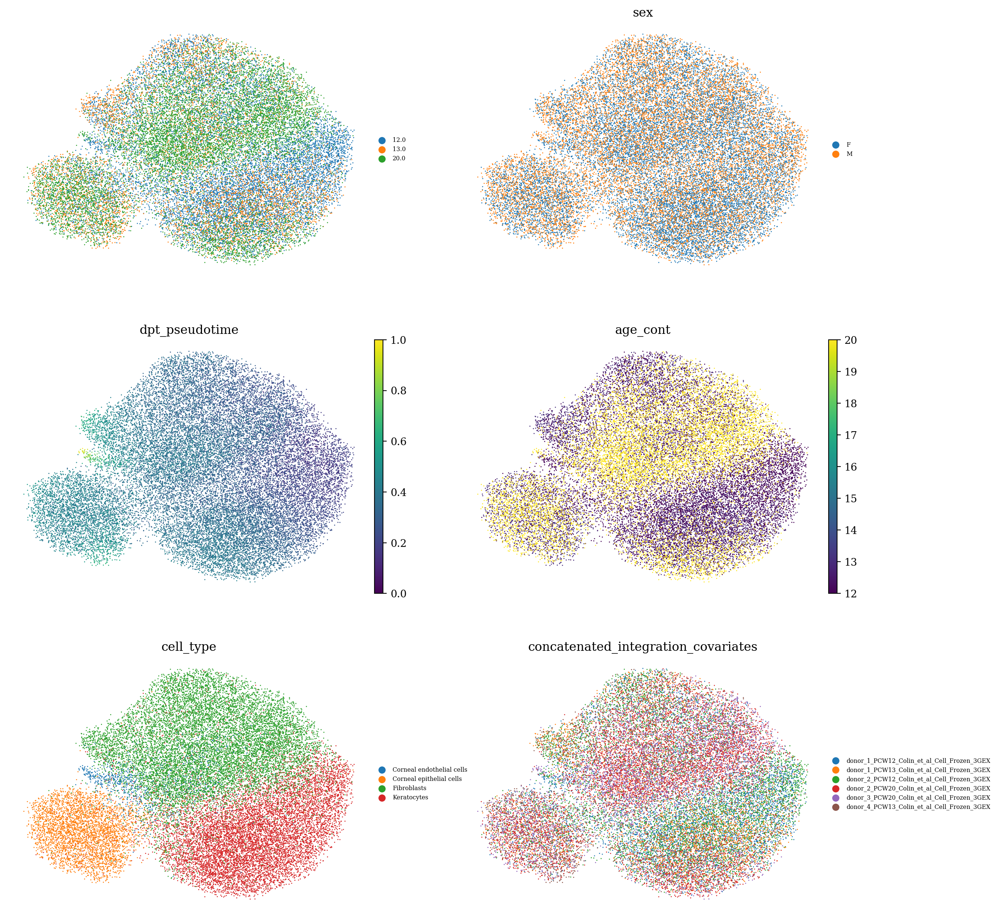

In [26]:
from tardis._disentenglementtargetmanager import DisentenglementTargetManager
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.unreserved_latent_indices], obs=adata.obs.copy())
prepare(latent)
display(latent.shape)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=["age", "sex", "dpt_pseudotime", "age_cont", "cell_type", "concatenated_integration_covariates"], 
        ncols=2,
        frameon=False,
        title="",
        legend_fontsize="xx-small"
    )

del latent
gc.collect();

(27033, 20)

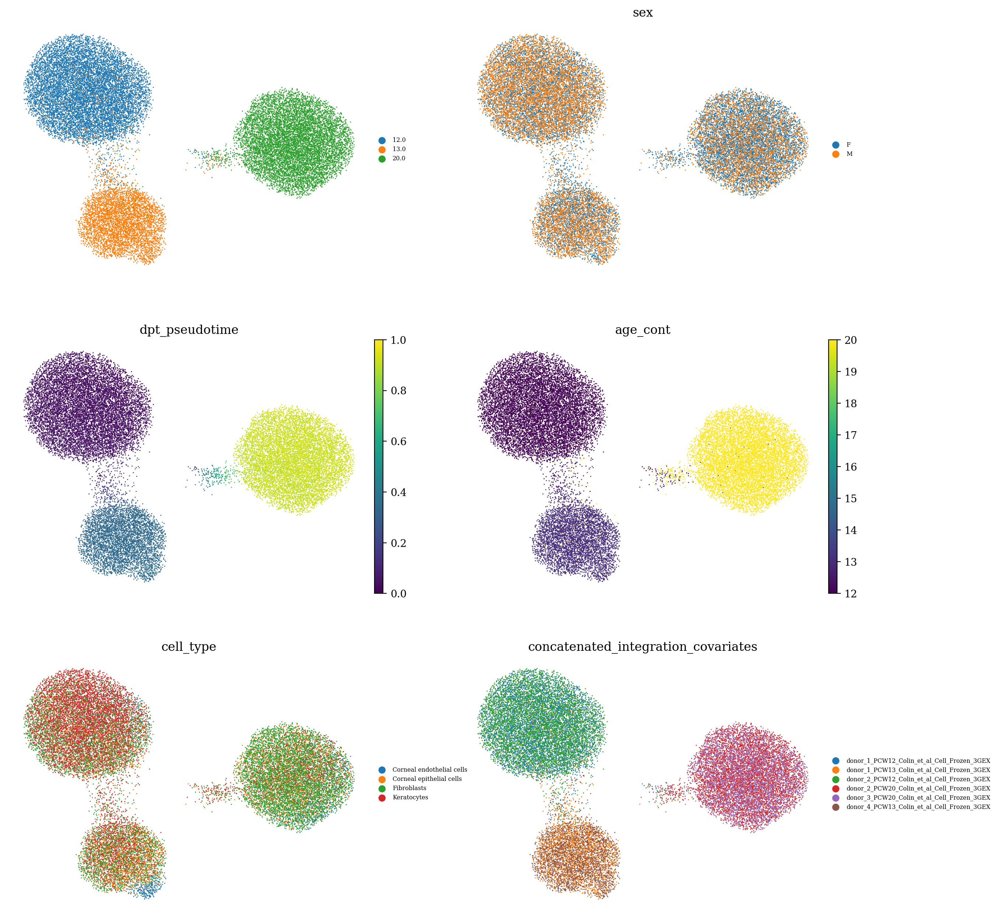

In [27]:
from tardis._disentenglementtargetmanager import DisentenglementTargetManager
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.get_by_obs_key("age").reserved_latent_indices], obs=adata.obs.copy())
prepare(latent)
display(latent.shape)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=["age", "sex", "dpt_pseudotime", "age_cont", "cell_type", "concatenated_integration_covariates"], 
        ncols=2,
        frameon=False,
        title="",
        legend_fontsize="xx-small"
    )

del latent
gc.collect();

(27033, 20)

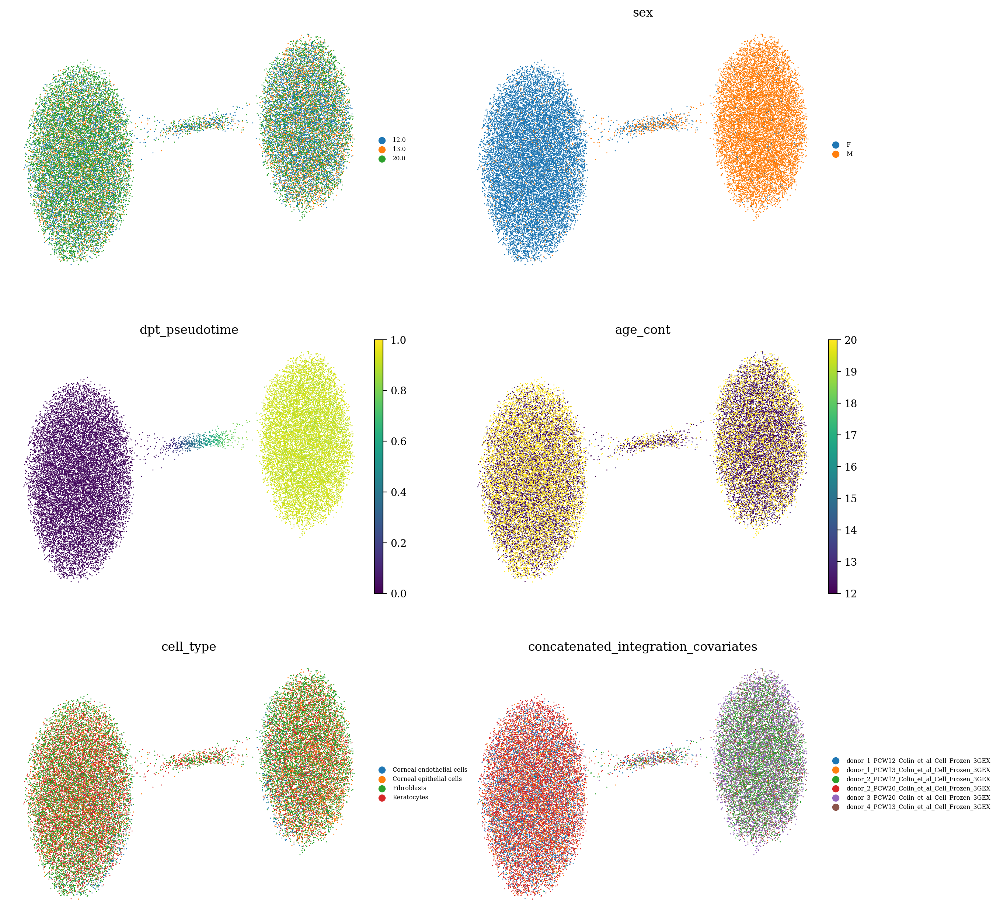

In [28]:
from tardis._disentenglementtargetmanager import DisentenglementTargetManager
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.get_by_obs_key("sex").reserved_latent_indices], obs=adata.obs.copy())
prepare(latent)
display(latent.shape)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=["age", "sex", "dpt_pseudotime", "age_cont", "cell_type", "concatenated_integration_covariates"], 
        ncols=2,
        frameon=False,
        title="",
        legend_fontsize="xx-small"
    )

del latent
gc.collect();

# Cell types

In [ ]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
for cell_type in latent.obs["cell_type"].unique():
    _latent = latent[latent.obs["cell_type"] == cell_type].copy()
    sc.pp.neighbors(_latent, n_neighbors = 30)
    sc.tl.umap(_latent)
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        sc.pl.umap(
            _latent, 
            color=["age", "sex", "concatenated_integration_covariates"], 
            ncols=3,
            frameon=False,
            title=cell_type,
            legend_fontsize="xx-small"
        )
    del _latent
    gc.collect();

del latent
gc.collect();

In [ ]:
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.get_by_obs_key("age").reserved_latent_indices], obs=adata.obs.copy())
for cell_type in latent.obs["cell_type"].unique():
    _latent = latent[latent.obs["cell_type"] == cell_type].copy()
    sc.pp.neighbors(_latent, n_neighbors = 30)
    sc.tl.umap(_latent)
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        sc.pl.umap(
            _latent, 
            color=["age", "sex", "concatenated_integration_covariates"], 
            ncols=3,
            frameon=False,
            title=cell_type,
            legend_fontsize="xx-small"
        )
    del _latent
    gc.collect();
    
del latent
gc.collect();

In [ ]:
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.get_by_obs_key("sex").reserved_latent_indices], obs=adata.obs.copy())
for cell_type in latent.obs["cell_type"].unique():
    _latent = latent[latent.obs["cell_type"] == cell_type].copy()
    sc.pp.neighbors(_latent, n_neighbors = 30)
    sc.tl.umap(_latent)
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        sc.pl.umap(
            _latent, 
            color=["age", "sex", "concatenated_integration_covariates"], 
            ncols=3,
            frameon=False,
            title=cell_type,
            legend_fontsize="xx-small"
        )
    del _latent
    gc.collect();
    
del latent
gc.collect();

In [ ]:
latent = ad.AnnData(X=vae.get_latent_representation()[:, DisentenglementTargetManager.configurations.unreserved_latent_indices], obs=adata.obs.copy())
for cell_type in latent.obs["cell_type"].unique():
    _latent = latent[latent.obs["cell_type"] == cell_type].copy()
    sc.pp.neighbors(_latent, n_neighbors = 30)
    sc.tl.umap(_latent)
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        sc.pl.umap(
            _latent, 
            color=["age", "sex", "concatenated_integration_covariates"], 
            ncols=3,
            frameon=False,
            title=cell_type,
            legend_fontsize="xx-small"
        )
    del _latent
    gc.collect();
    
del latent
gc.collect();